<h1 style='text-align:center;border:10px double;border-color:gray;'>
    <br/>
     PROJET 5<br/>
    <br/>
    <font color = 'Navy'>"Segmentez des clients d'un site e-commerce"</font>
    <br/>
    <br/>
    
</h1>
<h4 style='text-align:left;border-color:gray;'>
    <br/>
    <font color = 'Navy'>* notebook de l'essais</font>
    <br/>
</h4>

 Dirigé par :   [Pouria Forouzesh](https://www.linkedin.com/in/pouria-forouzesh/)

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import squarify
import matplotlib.cm as cm

from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.preprocessing import StandardScaler, Normalizer
from sklearn.decomposition import PCA,TruncatedSVD, NMF
from sklearn.manifold import TSNE

#from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.metrics import silhouette_score, davies_bouldin_score, adjusted_rand_score

from sklearn.cluster import KMeans
from yellowbrick.cluster import SilhouetteVisualizer
from scipy.stats import f_oneway

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

warnings.filterwarnings('ignore')

In [2]:
df_init = pd.read_csv('df_rfm_plus.csv', index_col='unique_id')
df_init.head()

,Recency,Frequency,num_product,MonetaryValue,review_score,payment_installments,num_category,weight_g,product_volume_cm3,order_purchase_timestamp
unique_id,,,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,2692.069444,1,1,141.90,5.0,1,1,1500.0,7616.0,2018-05-10 10:56:27
0000b849f77a49e4a4ce2b2a4ca5be3f,2763.819444,1,1,27.19,4.0,1,1,375.0,5148.0,2018-05-07 11:11:27
0000f46a3911fa3c0805444483337064,12905.926111,1,1,86.22,3.0,1,1,1500.0,43750.0,2017-03-10 21:05:03
0000f6ccb0745a6a4b88665a16c9f078,7722.515556,1,1,43.62,4.0,1,1,150.0,1045.0,2017-10-12 20:29:41
0004aac84e0df4da2b147fca70cf8255,6931.248611,1,1,196.89,5.0,1,1,6050.0,528.0,2017-11-14 19:45:42


In [3]:
work_RFM = pd.read_csv('df_rfm.csv', index_col='unique_id')
work_RFM.head()

,Recency,Frequency,MonetaryValue
unique_id,,,
0000366f3b9a7992bf8c76cfdf3221e2,2692.069444,1,141.90
0000b849f77a49e4a4ce2b2a4ca5be3f,2763.819444,1,27.19
0000f46a3911fa3c0805444483337064,12905.926111,1,86.22
0000f6ccb0745a6a4b88665a16c9f078,7722.515556,1,43.62
0004aac84e0df4da2b147fca70cf8255,6931.248611,1,196.89


## Création d'une segmentation RFM(Recency, Frequency, MonetaryValue)

La segmentation RFM se base sur des habitudes de consommations comme la date du dernier achat (Recency), la fréquence d'achat (Frequency) et la valeur moyenne/la somme moyenne dépensée lors d'une commande (MonetaryValue).

**Approche académique : la méthode des 11 segments**

In [4]:
# Calculation of scores with the help of quartiles
work_RFM['R'] = pd.qcut(work_RFM['Recency'], 5, ['5', '4', '3', '2', '1'])
work_RFM['F'] = pd.cut(work_RFM['Frequency'], 5, labels=['1', '2', '3','4','5'])
work_RFM['M'] = pd.qcut(work_RFM['MonetaryValue'], 5, ['1', '2', '3','4', '5'])

In [5]:
# Creation of RFM Score with the concatenation of R, F & M quartile/bins
work_RFM['RFM_Score'] = work_RFM["R"].astype(str) \
                    + work_RFM["F"].astype(str) \
                    + work_RFM["M"].astype(str)
work_RFM.sort_values("RFM_Score", ascending=True)

,Recency,Frequency,MonetaryValue,R,F,M,RFM_Score
unique_id,,,,,,,
39aa89a6522cd9e2fdc69f5165bde5f5,13971.013889,1,41.68,1,1,1,111
a41e44cb8ecf5a210067c6d19e35aead,13340.134167,1,38.62,1,1,1,111
c2ccefc0bb477cae8e2c242fca56a504,9311.759444,1,27.75,1,1,1,111
6e8fcf6171e78dd27e96456713c17f31,11231.761111,1,41.78,1,1,1,111
a423d0eb6e06ef44ce8ddb0e9cb579f7,11131.685000,1,21.76,1,1,1,111
...,...,...,...,...,...,...,...
181d08e7dcfdac616bf321a7ca3ad0ca,2140.828333,1,841.28,5,1,5,515
c82fcd6d4d15d0b52c8dad81603e46f8,498.578611,1,234.72,5,1,5,515
347bfbf36e1d0f1d044b3cb416a8b7c4,189.142222,1,267.68,5,1,5,515


![texte alternatif](RFM.png)


[Link](https://medium.com/simple-comme-data/la-segmentation-client%C3%A8le-par-lexemple-la-m%C3%A9thode-rfm-88bb6b06d7ed)

In [6]:
segt_map = {
    # segment 1
    '555': 'Champion','554': 'Champion','544': 'Champion','545': 'Champion','454': 'Champion','455': 'Champion','445': 'Champion',
    # segment 2
    '543': 'Loyal', '444': 'Loyal','435': 'Loyal','355': 'Loyal','354': 'Loyal','345': 'Loyal','344': 'Loyal','335': 'Loyal',
    # segment 3
    '553': 'Loyaliste potentiel', '551': 'Loyaliste potentiel','552': 'Loyaliste potentiel','541': 'Loyaliste potentiel','542': 'Loyaliste potentiel',
    '533': 'Loyaliste potentiel','532': 'Loyaliste potentiel','531': 'Loyaliste potentiel','452': 'Loyaliste potentiel','451': 'Loyaliste potentiel',
    '442': 'Loyaliste potentiel','441': 'Loyaliste potentiel','431': 'Loyaliste potentiel','453': 'Loyaliste potentiel','433': 'Loyaliste potentiel',
    '432': 'Loyaliste potentiel','423': 'Loyaliste potentiel','353': 'Loyaliste potentiel','352': 'Loyaliste potentiel','351': 'Loyaliste potentiel',
    '342': 'Loyaliste potentiel','341': 'Loyaliste potentiel','333': 'Loyaliste potentiel','323': 'Loyaliste potentiel',
    # segment 4
    '512': 'Nouveaux clients','511': 'Nouveaux clients','422': 'Nouveaux clients','421': 'Nouveaux clients','412': 'Nouveaux clients',
    '411': 'Nouveaux clients','311': 'Nouveaux clients',
    # segment 5
    '525': 'Prometteur','524': 'Prometteur','523': 'Prometteur','522': 'Prometteur','521': 'Prometteur','515': 'Prometteur',
    '514': 'Prometteur','513': 'Prometteur','425': 'Prometteur','424': 'Prometteur','413': 'Prometteur','414': 'Prometteur',
    '415': 'Prometteur','315': 'Prometteur','314': 'Prometteur','313': 'Prometteur',
    # segment 6
    '535': 'Client standard','534': 'Client standard','443': 'Client standard','434': 'Client standard','343': 'Client standard',
    '324': 'Client standard', '334': 'Client standard','325': 'Client standard',
    # segment 7
    '331': 'Besoin d\'attantion','321': 'Besoin d\'attantion','312': 'Besoin d\'attantion','221': 'Besoin d\'attantion',
    '213': 'Besoin d\'attantion','231': 'Besoin d\'attantion','241': 'Besoin d\'attantion','251': 'Besoin d\'attantion',
    # segment 8
    '255': 'A ne pas perdre','254': 'A ne pas perdre','245': 'A ne pas perdre','244': 'A ne pas perdre','253': 'A ne pas perdre',
    '252': 'A ne pas perdre','243': 'A ne pas perdre','242': 'A ne pas perdre','235': 'A ne pas perdre','234': 'A ne pas perdre',
    '225': 'A ne pas perdre','224': 'A ne pas perdre','153': 'A ne pas perdre','152': 'A ne pas perdre','145': 'A ne pas perdre',
    '143': 'A ne pas perdre','142': 'A ne pas perdre','135': 'A ne pas perdre','134': 'A ne pas perdre','133': 'A ne pas perdre',
    '125': 'A ne pas perdre','124': 'A ne pas perdre',
    # segment 9
    '155': 'A risques','154': 'A risques','144': 'A risques','214': 'A risques',
    '215': 'A risques','115': 'A risques','114': 'A risques','113': 'A risques',
    # segment 10
    '332': 'Perdu mais engagé', '322': 'Perdu mais engagé','233': 'Perdu mais engagé','232': 'Perdu mais engagé','223': 'Perdu mais engagé',
    '222': 'Perdu mais engagé','132': 'Perdu mais engagé','123': 'Perdu mais engagé','122': 'Perdu mais engagé','212': 'Perdu mais engagé',
    '211': 'Perdu mais engagé',
    # segment 11
    '111': 'Perdu','112': 'Perdu','121': 'Perdu','131': 'Perdu','141': 'Perdu','151': 'Perdu',
               
        
}

In [7]:
work_RFM["rfm_segment_name"] = work_RFM["RFM_Score"].map(segt_map)
work_RFM

,Recency,Frequency,MonetaryValue,R,F,M,RFM_Score,rfm_segment_name
unique_id,,,,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,2692.069444,1,141.90,4,1,4,414,Prometteur
0000b849f77a49e4a4ce2b2a4ca5be3f,2763.819444,1,27.19,4,1,1,411,Nouveaux clients
0000f46a3911fa3c0805444483337064,12905.926111,1,86.22,1,1,2,112,Perdu
0000f6ccb0745a6a4b88665a16c9f078,7722.515556,1,43.62,2,1,1,211,Perdu mais engagé
0004aac84e0df4da2b147fca70cf8255,6931.248611,1,196.89,2,1,4,214,A risques
...,...,...,...,...,...,...,...,...
fffcf5a5ff07b0908bd4e2dbc735a684,10746.000278,1,2067.42,1,1,5,115,A risques
fffea47cd6d3cc0a88bd621562a9d061,6306.878056,1,84.58,3,1,2,312,Besoin d'attantion
ffff371b4d645b6ecea244b27531430a,13655.189167,1,112.46,1,1,3,113,A risques


In [8]:
work_RFM.rfm_segment_name.nunique()

8

In [9]:
work_RFM_count = work_RFM['rfm_segment_name'].value_counts()

work_RFM_count

Prometteur            33778
Nouveaux clients      18565
A risques             18479
Perdu                  7605
Perdu mais engagé      7513
Besoin d'attantion     7368
A ne pas perdre          34
Client standard           7
Name: rfm_segment_name, dtype: int64

In [10]:
import plotly.graph_objects as go

# Créer le graphique à barres
fig = go.Figure(data=go.Bar(x=work_RFM_count.index, y = work_RFM_count.values))

# labels
fig.update_layout(
    xaxis=dict(title='Nom de segment'),
    yaxis=dict(title='Nombre de clients')
)

# Afficher le graphique
fig.show()


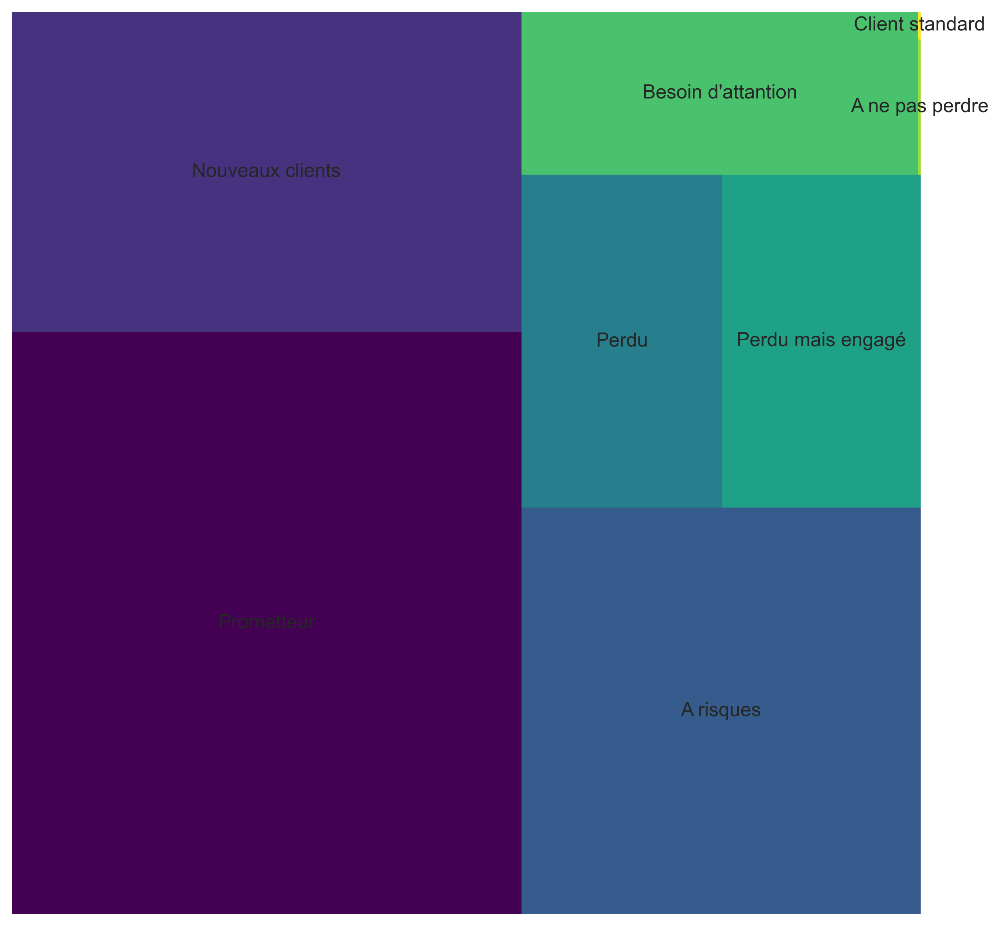

In [11]:
plt.figure(figsize=(10,10), dpi=300)

# Define the data for the treemap
data = work_RFM_count#.Value
labels = work_RFM_count.index

# Create a color map based on the data values
data_unique = np.unique(labels)
colormap = cm.get_cmap('viridis', len(data_unique))
color = colormap(np.arange(len(data_unique)))
data_color = [color[i] for i in range(len(data))]


# Plot the treemap with sizes proportional to the values
squarify.plot(sizes=data, label=labels, color=data_color)

# Show the plot
plt.axis('off')
plt.show()

## KMeans 5 variables

### PCA (Analyse des Composantes Principales)

In [12]:
df = df_init.drop(['num_category', 'weight_g', 'product_volume_cm3', 'payment_installments', 'order_purchase_timestamp'], axis=1)
print(df.isna().sum())
df.head()

Recency          0
Frequency        0
num_product      0
MonetaryValue    0
review_score     0
dtype: int64


,Recency,Frequency,num_product,MonetaryValue,review_score
unique_id,,,,,
0000366f3b9a7992bf8c76cfdf3221e2,2692.069444,1,1,141.90,5.0
0000b849f77a49e4a4ce2b2a4ca5be3f,2763.819444,1,1,27.19,4.0
0000f46a3911fa3c0805444483337064,12905.926111,1,1,86.22,3.0
0000f6ccb0745a6a4b88665a16c9f078,7722.515556,1,1,43.62,4.0
0004aac84e0df4da2b147fca70cf8255,6931.248611,1,1,196.89,5.0


In [13]:
# Création d'un objet StandardScaler
scaler = StandardScaler()

# Ajustement du scaler aux données et transformation des données
data_scaled = scaler.fit_transform(df)

# Affichage des données transformées
#print("Données d'origine :\n", data)
print("Données transformées :\n", data_scaled)

Données transformées :
 [[-0.8422668  -0.1598373  -0.28222026 -0.12001465  0.6580778 ]
 [-0.82273972 -0.1598373  -0.28222026 -0.56384564 -0.12442976]
 [ 1.93747962 -0.1598373  -0.28222026 -0.33544931 -0.90693733]
 ...
 [ 2.14139489 -0.1598373  -0.28222026 -0.23392263  0.6580778 ]
 [-0.79119808 -0.1598373  -0.28222026 -0.15178043  0.6580778 ]
 [ 1.59150919 -0.1598373  -0.28222026 -0.39217115  0.6580778 ]]


In [14]:
# Création d'un objet PCA avec toutes les composantes principales
n_comp = 2
pca = PCA(n_components=n_comp)

# Ajustement du PCA aux données
pca.fit(data_scaled)

df_pca = pca.transform(data_scaled)

# Inertie expliquée par chaque composante principale
explained_variance = pca.explained_variance_

# Pourcentage d'inertie expliquée par chaque composante principale
explained_variance_ratio = pca.explained_variance_ratio_

# Composants principaux (vecteurs propres)
components = pca.components_

# Affichage des résultats
# print("Inertie expliquée par chaque composante principale :", explained_variance)
# print("Pourcentage d'inertie expliquée par chaque composante principale :", explained_variance_ratio)
# print("Composants principaux (vecteurs propres) :", components)


Text(0, 0.5, 'Composante 2')

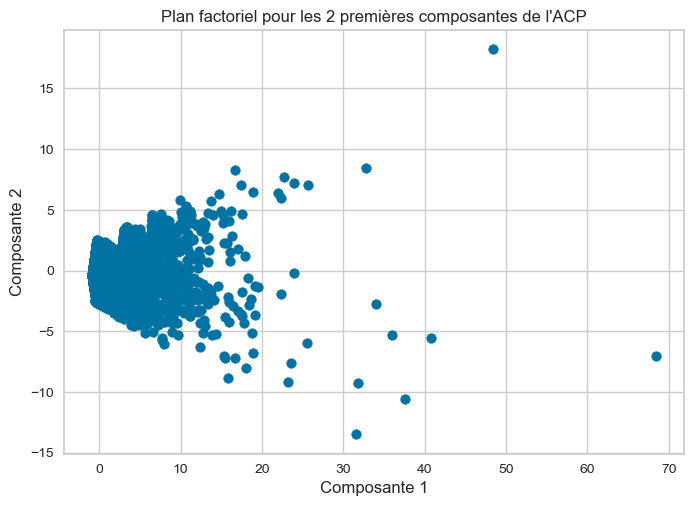

In [15]:
plt.scatter(x = df_pca[:,0], y = df_pca[:,1])

plt.title("Plan factoriel pour les 2 premières composantes de l'ACP")
plt.xlabel('Composante 1')
plt.ylabel('Composante 2')

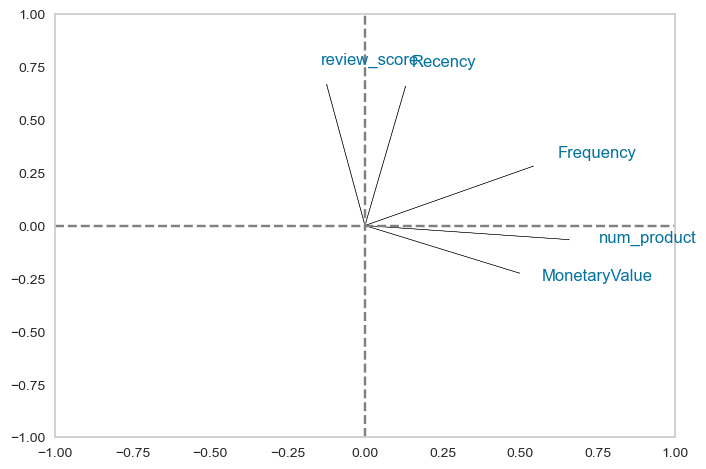

In [16]:
# Obtenez les charges factorielles
loadings = pca.components_.T

# Définissez les limites du plot
plt.xlim(-1, 1)
plt.ylim(-1, 1)

# Tracez les flèches des charges factorielles
for i, feature in enumerate(df.columns):
    plt.arrow(0, 0, loadings[i, 0], loadings[i, 1], color='black', alpha=0.8)
    plt.text(loadings[i, 0] * 1.15, loadings[i, 1] * 1.15, feature, color='b')

# Ajoutez des lignes de référence
plt.plot([-1, 1], [0, 0], color='gray', ls='--')
plt.plot([0, 0], [-1, 1], color='gray', ls='--')

# Ajoutez une grille pour une meilleure lisibilité
plt.grid()

# Affichez le plot
plt.show()


**Echantillon réduit**

In [17]:
data_reduce = df.sample(10000, random_state=42).copy()
X = data_reduce.copy()
X.shape

(10000, 5)

In [18]:
# Création d'un objet PCA avec toutes les composantes principales
n_comp = 2
pca_reduce = PCA(n_components=n_comp)

# Ajustement du PCA aux données
pca_reduce.fit(X)

df_pca_reduce = pca_reduce.transform(X)

# Inertie expliquée par chaque composante principale
explained_variance_reduce = pca_reduce.explained_variance_

# Pourcentage d'inertie expliquée par chaque composante principale
explained_variance_ratio_reduce = pca_reduce.explained_variance_ratio_

# Composants principaux (vecteurs propres)
components_reduce = pca_reduce.components_

Text(0, 0.5, 'Composante 2')

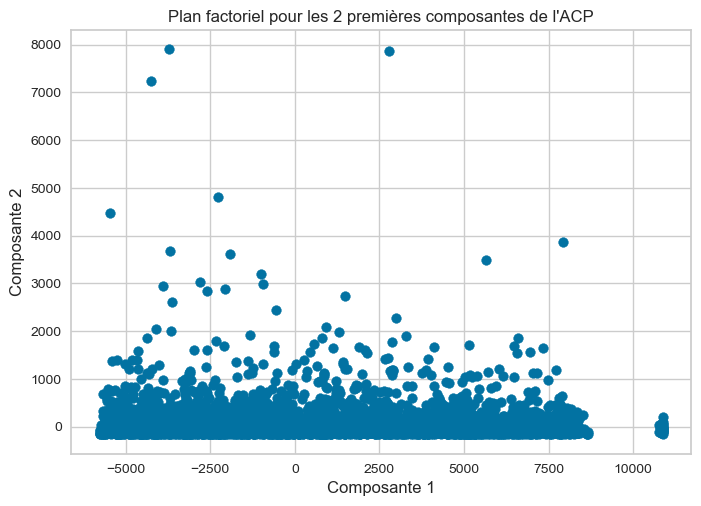

In [19]:
plt.scatter(x = df_pca_reduce[:,0], y = df_pca_reduce[:,1])

plt.title("Plan factoriel pour les 2 premières composantes de l'ACP")
plt.xlabel('Composante 1')
plt.ylabel('Composante 2')

### T-SNE

**utilisons l'algorithme T-SNE pour avoir une idée en première approche du nombre de groupes homogènes**

In [20]:
tsne = TSNE(n_components=2)
T = tsne.fit_transform(df_pca_reduce.copy())

<Axes: title={'center': 'Représentation du jeu de données via T-SNE'}>

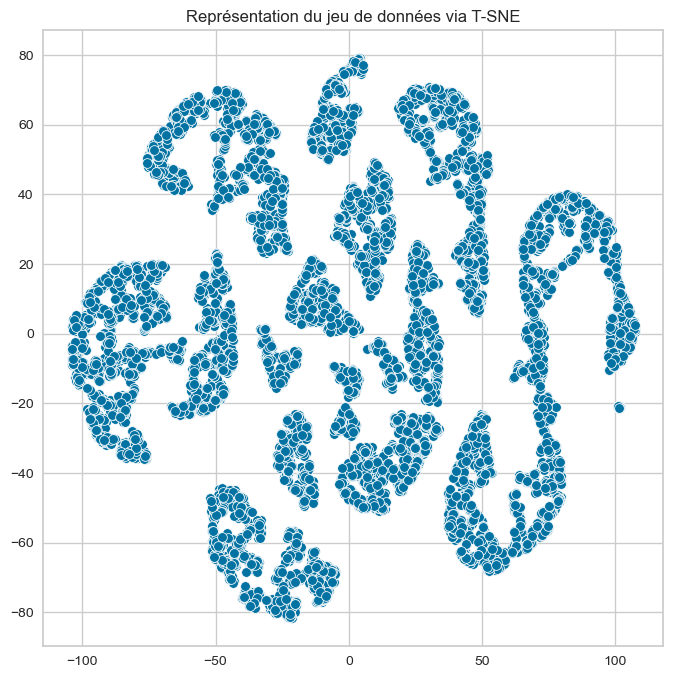

In [21]:
plt.figure(figsize=(8,8))
plt.title('Représentation du jeu de données via T-SNE')
sns.scatterplot(x= T[:,0],y = T[:,1])

### Modélisation : K-Means

**Elbow method kMeans**

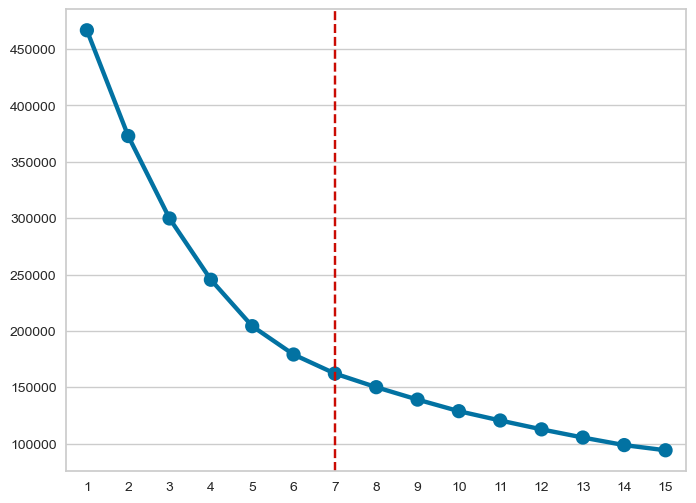

In [22]:
wcss = {}
for i in range(1,16):
    kmeans = KMeans(n_clusters=  i, init = 'k-means++', max_iter= 300,  random_state = 42) #
    kmeans.fit(data_scaled)
    wcss[i] = kmeans.inertia_
    

plt.figure(figsize = (8,6))
sns.pointplot(x = list(wcss.keys()), y = list(wcss.values()))

# Tracé de la ligne verticale
plt.axvline(x=6, color='r', linestyle='--')

plt.show();

**Silhouette method kMeans**

Silhouette Score: [0.6813925173940566, 0.3919196663821715, 0.3581091990597788, 0.3755634842349182, 0.3852429520466829, 0.3917435635090914, 0.3150199843692109, 0.32201583592432037, 0.3186423273342363, 0.3244956730959504, 0.32498220904175074, 0.3323400411805802, 0.3327568695072317, 0.3429392861054393]
Silhouette Score: 0.3429392861054393


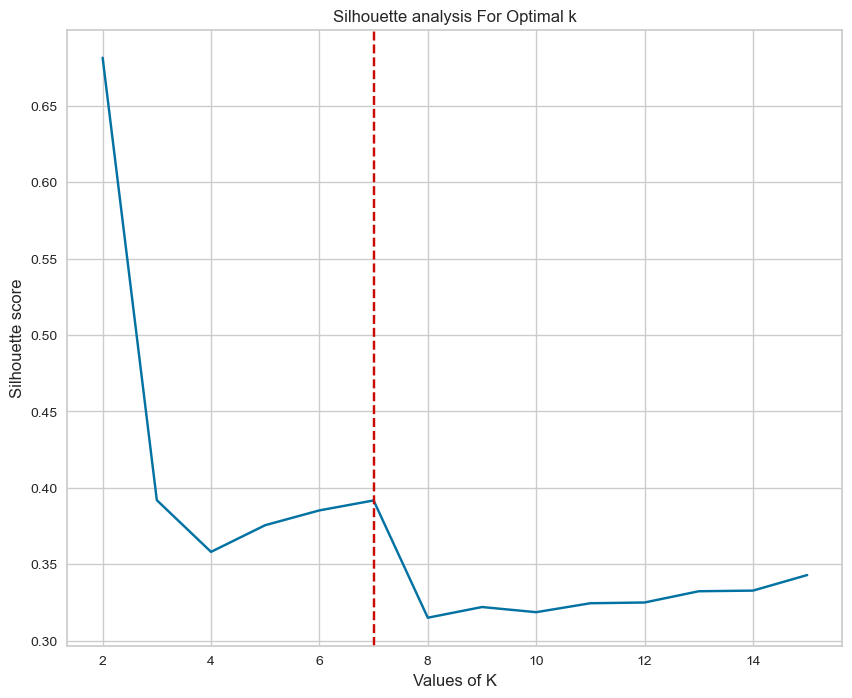

In [23]:
range_n_clusters = [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]
silhouette_avg = []
for num_clusters in range_n_clusters:
 
    # initialise kmeans
    kmeans1 = KMeans(n_clusters=num_clusters, init = 'k-means++', max_iter= 300,  random_state = 42)
    kmeans1.fit(data_scaled)
    cluster_labels = kmeans1.labels_
 
   # silhouette score
    silhouette_avg.append(silhouette_score(data_scaled, cluster_labels))

print("Silhouette Score:" , silhouette_avg)
print("Silhouette Score:", silhouette_score(data_scaled, cluster_labels))
    
plt.figure(figsize = (10,8))    
plt.plot(range_n_clusters,silhouette_avg, 'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Silhouette score') 
plt.title('Silhouette analysis For Optimal k')

# Tracé de la ligne verticale
plt.axvline(x=7, color='r', linestyle='--')

plt.show()

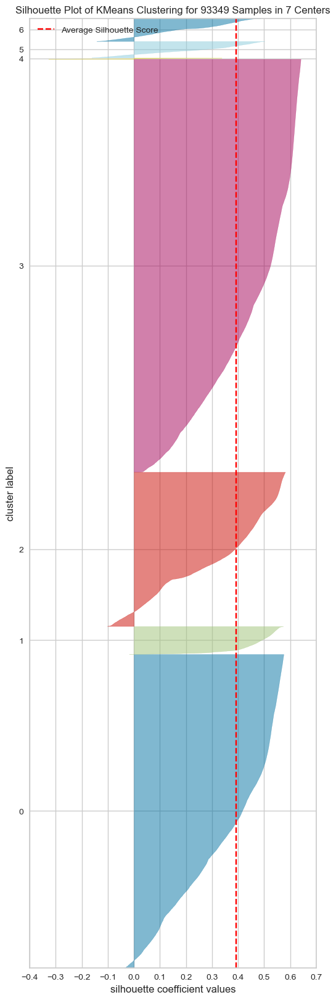

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 93349 Samples in 7 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [24]:
plt.figure(figsize = (6,20))
kmeans_1 = KMeans(n_clusters=7, init = 'k-means++', max_iter= 300,  random_state = 42)

visualizer = SilhouetteVisualizer(kmeans_1, colors='yellowbrick')

visualizer.fit(data_scaled)
visualizer.show()


##### 14 Cluster et 5 variables

In [25]:
# Créer une instance de l'algorithme K-means avec 3 clusters
kmeans_4 = KMeans(n_clusters=14, random_state=42)

# Effectuer le clustering sur les données
kmeans_4.fit(data_scaled)

# Obtenir les labels de cluster assignés à chaque point de données
labels_4 = kmeans_4.labels_

# Obtenir les coordonnées des centres de cluster
centroids = kmeans_4.cluster_centers_

# # Afficher les résultats
# print("Labels de cluster:")
# print(labels_4)
# print("Coordonnées des centres de cluster:")
# print(centroids)

In [26]:
df_kmeans_4 = pd.DataFrame(data_scaled, columns = df.columns)
df_kmeans_4['km_clusters'] = labels_4
df_kmeans_4

,Recency,Frequency,num_product,MonetaryValue,review_score,km_clusters
0,-0.842267,-0.159837,-0.282220,-0.120015,0.658078,7
1,-0.822740,-0.159837,-0.282220,-0.563846,-0.124430,1
2,1.937480,-0.159837,-0.282220,-0.335449,-0.906937,12
3,0.526791,-0.159837,-0.282220,-0.500275,-0.124430,4
4,0.311445,-0.159837,-0.282220,0.092750,0.658078,4
...,...,...,...,...,...,...
93344,1.349646,-0.159837,0.917788,7.330124,0.658078,11
93345,0.141519,-0.159837,-0.282220,-0.341795,-0.124430,4
93346,2.141395,-0.159837,-0.282220,-0.233923,0.658078,2
93347,-0.791198,-0.159837,-0.282220,-0.151780,0.658078,7


In [27]:
df_kmeans_4['km_clusters'].value_counts()

4     22135
7     21165
2     15346
1     13125
5      8331
12     4923
0      2792
3      2495
9      2137
11      464
10      222
6       177
8        19
13       18
Name: km_clusters, dtype: int64

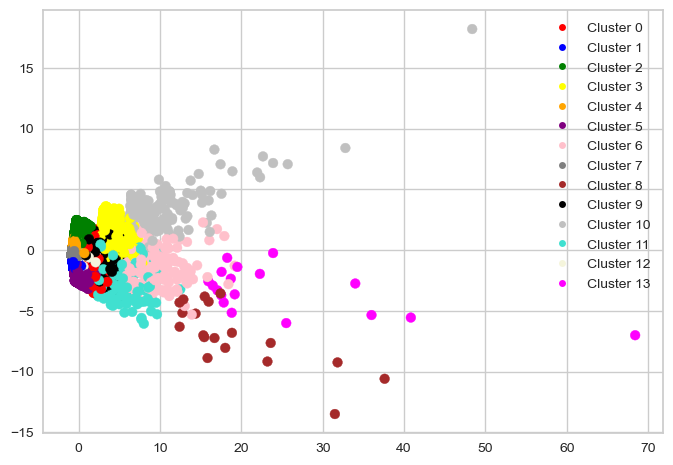

In [28]:
color_mapping = {
    0: 'red',
    1: 'blue',
    2: 'green',
    3: 'yellow',
    4: 'orange',
    5: 'purple',
    6: 'pink',
    7: 'gray',
    8: 'brown',
    9: 'black',
    10: 'silver',
    11: 'turquoise',
    12: 'beige',
    13: 'magenta'
}

# Tracer le graphique de dispersion
scatter = plt.scatter(x=df_pca[:, 0], y=df_pca[:, 1], c=[color_mapping[i] for i in df_kmeans_4['km_clusters']])

# Créer une légende
legend_labels = ['Cluster 0', 'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5', 'Cluster 6', 'Cluster 7', 'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12', 'Cluster 13']
legend_handles = [plt.Line2D([], [], marker='o', color=color_mapping[i], linestyle='', markersize=5) for i in range(len(legend_labels))]
plt.legend(legend_handles, legend_labels)

# Afficher le graphique
plt.show()


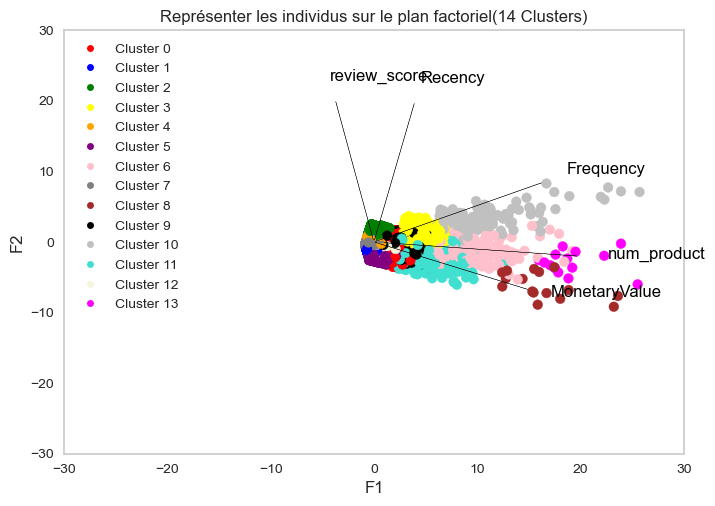

In [29]:
color_mapping = {
    0: 'red',
    1: 'blue',
    2: 'green',
    3: 'yellow',
    4: 'orange',
    5: 'purple',
    6: 'pink',
    7: 'gray',
    8: 'brown',
    9: 'black',
    10: 'silver',
    11: 'turquoise',
    12: 'beige',
    13: 'magenta'
}

# Tracer le graphique de dispersion
scatter = plt.scatter(x=df_pca[:, 0], y=df_pca[:, 1], c=[color_mapping[i] for i in df_kmeans_4['km_clusters']])

# Créer une légende
legend_labels = ['Cluster 0', 'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5', 'Cluster 6', 'Cluster 7', 'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12', 'Cluster 13']
legend_handles = [plt.Line2D([], [], marker='o', color=color_mapping[i], linestyle='', markersize=5) for i in range(len(legend_labels))]
plt.legend(legend_handles, legend_labels)

# Tracer le cercle de corrélation
plt.xlim(-30, 30)
plt.ylim(-30, 30)

for i, feature in enumerate(df.columns):
    plt.arrow(0, 0, loadings[i, 0]*30, loadings[i, 1]*30, color='black', alpha=0.8)
    plt.text(loadings[i, 0] * 1.15 *30, loadings[i, 1] * 1.15 *30, feature, color='black')

plt.plot([-1, 1], [0, 0], color='gray', ls='--')
plt.plot([0, 0], [-1, 1], color='gray', ls='--')

plt.title('Représenter les individus sur le plan factoriel(14 Clusters)')
plt.xlabel('F1')
plt.ylabel('F2')
plt.grid()
plt.show()


##### 7 Cluster et  5 variables

In [30]:
# Créer une instance de l'algorithme K-means avec 7 clusters
kmeans_7 = KMeans(n_clusters=7, random_state=42)

# Effectuer le clustering sur les données
kmeans_7.fit(data_scaled)

# Obtenir les labels de cluster assignés à chaque point de données
labels_7 = kmeans_7.labels_

# Obtenir les coordonnées des centres de cluster
centroids = kmeans_7.cluster_centers_

# Afficher les résultats
# print("Labels de cluster:")
# print(labels_7)
# print("Coordonnées des centres de cluster:")
# print(centroids)

In [31]:
df_kmeans_7 = pd.DataFrame(data_scaled, columns = df.columns)
df_kmeans_7['km_clusters'] = labels_7

In [32]:
df_kmeans_7['km_clusters'].value_counts()

3    40621
0    30847
2    15171
1     2743
6     2232
5     1614
4      121
Name: km_clusters, dtype: int64

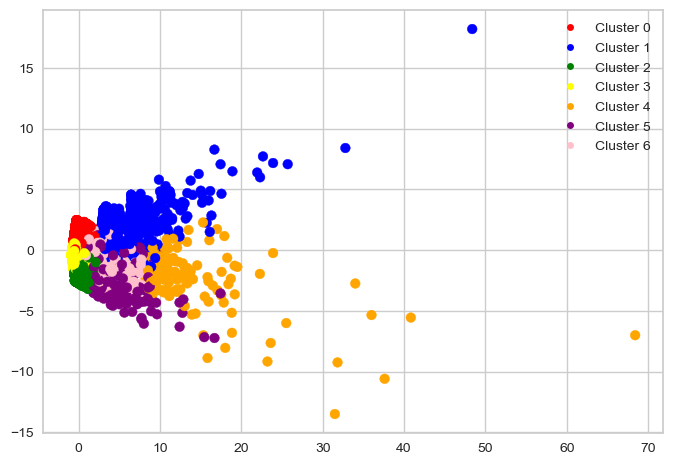

In [33]:
color_mapping = {
    0: 'red',
    1: 'blue',
    2: 'green',
    3: 'yellow',
    4: 'orange',
    5: 'purple',
    6: 'pink'
}

# Tracer le graphique de dispersion
scatter = plt.scatter(x=df_pca[:, 0], y=df_pca[:, 1], c=[color_mapping[i] for i in df_kmeans_7['km_clusters']])

# Créer une légende
legend_labels = ['Cluster 0', 'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5', 'Cluster 6']
legend_handles = [plt.Line2D([], [], marker='o', color=color_mapping[i], linestyle='', markersize=5) for i in range(len(legend_labels))]
plt.legend(legend_handles, legend_labels)

# Afficher le graphique
plt.show()



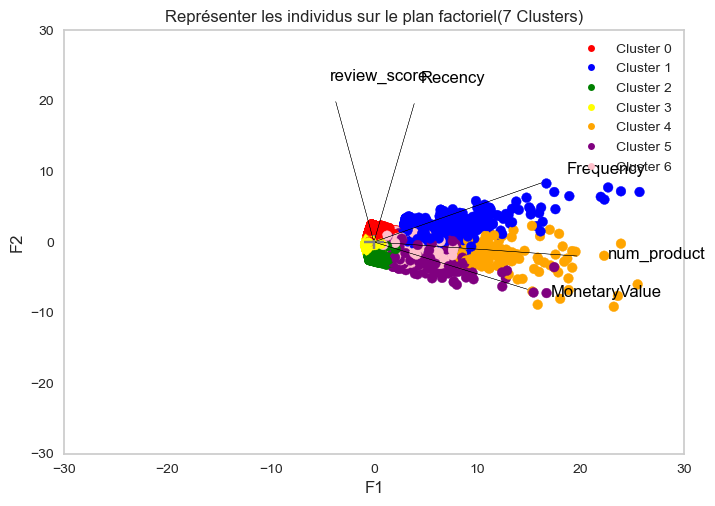

In [34]:
# Tracer les points scatter avec les clusters
color_mapping = {
    0: 'red',
    1: 'blue',
    2: 'green',
    3: 'yellow',
    4: 'orange',
    5: 'purple',
    6: 'pink'
}

# Tracer le graphique de dispersion
scatter = plt.scatter(x=df_pca[:, 0], y=df_pca[:, 1], c=[color_mapping[i] for i in df_kmeans_7['km_clusters']])

# Créer une légende
legend_labels = ['Cluster 0', 'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5', 'Cluster 6']
legend_handles = [plt.Line2D([], [], marker='o', color=color_mapping[i], linestyle='', markersize=5) for i in range(len(legend_labels))]
plt.legend(legend_handles, legend_labels)

# Tracer le cercle de corrélation
plt.xlim(-30, 30)
plt.ylim(-30, 30)

for i, feature in enumerate(df.columns):
    plt.arrow(0, 0, loadings[i, 0]*30, loadings[i, 1]*30, color='black', alpha=0.8)
    plt.text(loadings[i, 0] * 1.15 *30, loadings[i, 1] * 1.15 *30, feature, color='black')

plt.plot([-1, 1], [0, 0], color='gray', ls='--')
plt.plot([0, 0], [-1, 1], color='gray', ls='--')

plt.title('Représenter les individus sur le plan factoriel(7 Clusters)')
plt.xlabel('F1')
plt.ylabel('F2')
plt.grid()
plt.show()

In [35]:
kmean_analysis = df_kmeans_7.groupby('km_clusters').mean()
kmean_analysis

,Recency,Frequency,num_product,MonetaryValue,review_score
km_clusters,,,,,
0,1.002067,-0.159837,-0.173178,-0.138784,0.379316
1,0.447877,5.164633,1.695628,0.502194,0.045074
2,-0.067824,-0.159837,-0.051805,-0.086441,-1.896406
3,-0.765010,-0.159837,-0.188278,-0.146656,0.431933
4,0.254866,1.618689,14.494739,7.861441,-0.540253
5,-0.034944,-0.106504,0.075403,4.763045,0.006150
6,-0.004167,-0.153410,3.247911,0.687041,-0.243769


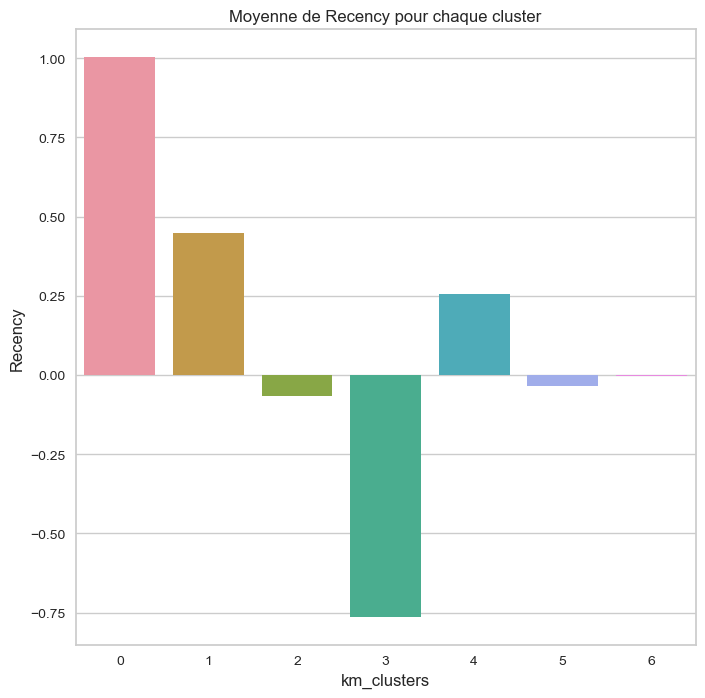

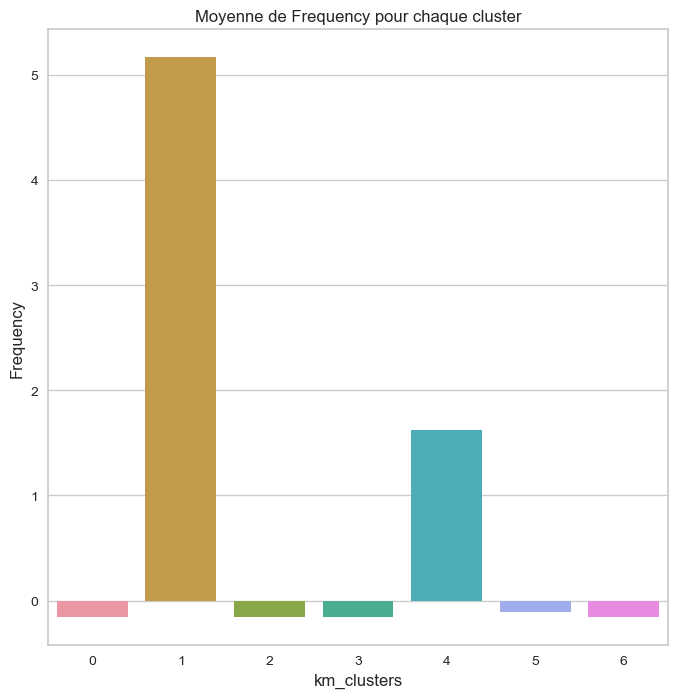

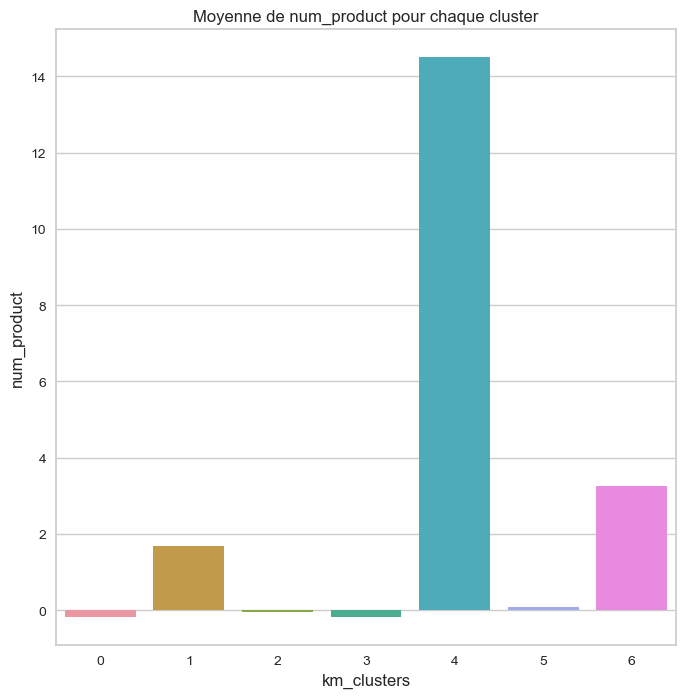

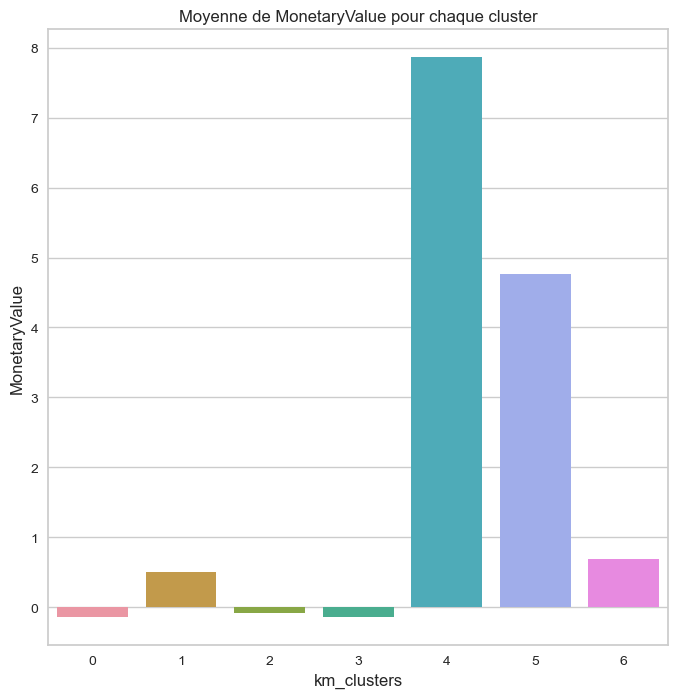

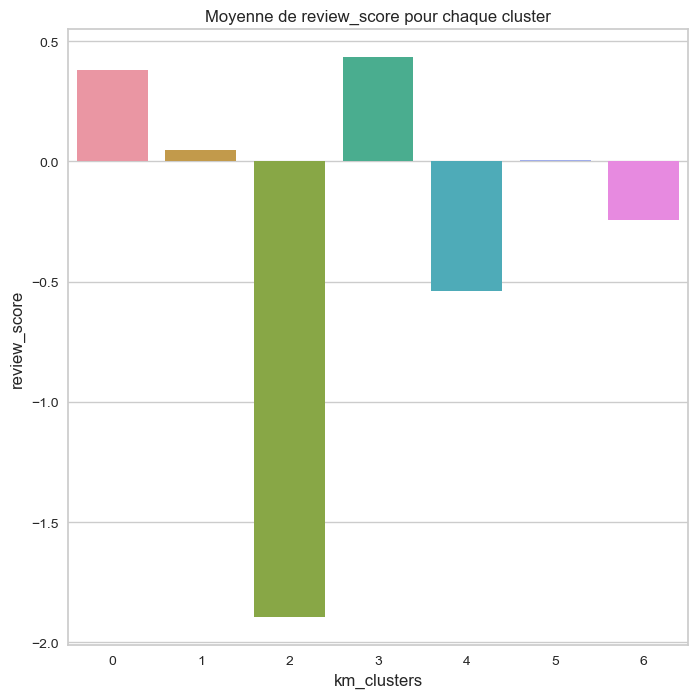

In [36]:
for column in kmean_analysis.columns:
    try:
        plt.figure(figsize=(8,8))
        titre = 'Moyenne de ' + str(column) + ' pour chaque cluster' 
        plt.title(titre)
        sns.barplot(x = kmean_analysis.index,
                    y = column,
                    data = kmean_analysis 
                    )
        plt.show()
    except:
        print('Erreur colonne : ', column)

**Analyse de la variance (ANOVA)**

In [37]:
# anova de Recency
groupe1_Recency = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 0]['Recency'])
groupe2_Recency = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 1]['Recency'])
groupe3_Recency = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 2]['Recency'])
groupe4_Recency = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 3]['Recency'])
groupe5_Recency = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 4]['Recency'])
groupe6_Recency = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 5]['Recency'])
groupe7_Recency = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 6]['Recency'])

# ANOVA à un facteur
statistique_Recency, p_value_Recency = f_oneway(groupe1_Recency, groupe2_Recency, groupe3_Recency,
                               groupe4_Recency, groupe5_Recency, groupe6_Recency,
                               groupe7_Recency)

# Affichage des résultats
print("Statistique de l'ANOVA :", statistique_Recency)
print("Valeur de p :", p_value_Recency)

Statistique de l'ANOVA : 22688.39515279173
Valeur de p : 0.0


In [38]:
# anova de Frequency
groupe1_Frequency = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 0]['Frequency'])
groupe2_Frequency = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 1]['Frequency'])
groupe3_Frequency = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 2]['Frequency'])
groupe4_Frequency = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 3]['Frequency'])
groupe5_Frequency = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 4]['Frequency'])
groupe6_Frequency = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 5]['Frequency'])
groupe7_Frequency = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 6]['Frequency'])

# ANOVA à un facteur
statistique_Frequency, p_value_Frequency = f_oneway(groupe1_Frequency, groupe2_Frequency, groupe3_Frequency,
                               groupe4_Frequency, groupe5_Frequency, groupe6_Frequency,
                               groupe7_Frequency)

# Affichage des résultats
print("Statistique de l'ANOVA :", statistique_Frequency)
print("Valeur de p :", p_value_Frequency)

Statistique de l'ANOVA : 67038.51823793833
Valeur de p : 0.0


In [39]:
# anova de MonetaryValue
groupe1_MonetaryValue = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 0]['MonetaryValue'])
groupe2_MonetaryValue = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 1]['MonetaryValue'])
groupe3_MonetaryValue = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 2]['MonetaryValue'])
groupe4_MonetaryValue = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 3]['MonetaryValue'])
groupe5_MonetaryValue = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 4]['MonetaryValue'])
groupe6_MonetaryValue = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 5]['MonetaryValue'])
groupe7_MonetaryValue = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 6]['MonetaryValue'])

# ANOVA à un facteur
statistique_MonetaryValue, p_value_MonetaryValue = f_oneway(groupe1_MonetaryValue, groupe2_MonetaryValue, groupe3_MonetaryValue,
                               groupe4_MonetaryValue, groupe5_MonetaryValue, groupe6_MonetaryValue,
                               groupe7_MonetaryValue)

# Affichage des résultats
print("Statistique de l'ANOVA :", statistique_MonetaryValue)
print("Valeur de p :", p_value_MonetaryValue)

Statistique de l'ANOVA : 16062.555857569929
Valeur de p : 0.0


In [40]:
# anova de num_product
groupe1_num_product = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 0]['num_product'])
groupe2_num_product = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 1]['num_product'])
groupe3_num_product = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 2]['num_product'])
groupe4_num_product = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 3]['num_product'])
groupe5_num_product = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 4]['num_product'])
groupe6_num_product = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 5]['num_product'])
groupe7_num_product = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 6]['num_product'])

# ANOVA à un facteur
statistique_num_product, p_value_num_product = f_oneway(groupe1_num_product, groupe2_num_product, groupe3_num_product,
                               groupe4_num_product, groupe5_num_product, groupe6_num_product,
                               groupe7_num_product)

# Affichage des résultats
print("Statistique de l'ANOVA :", statistique_num_product)
print("Valeur de p :", p_value_num_product)

Statistique de l'ANOVA : 27054.791020063407
Valeur de p : 0.0


In [41]:
# anova de num_product
groupe1_review_score = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 0]['review_score'])
groupe2_review_score = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 1]['review_score'])
groupe3_review_score = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 2]['review_score'])
groupe4_review_score = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 3]['review_score'])
groupe5_review_score = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 4]['review_score'])
groupe6_review_score = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 5]['review_score'])
groupe7_review_score = list(df_kmeans_7[df_kmeans_7['km_clusters'] == 6]['review_score'])

# ANOVA à un facteur
statistique_review_score, p_value_review_score = f_oneway(groupe1_review_score, groupe2_review_score, groupe3_review_score,
                               groupe4_num_product, groupe5_review_score, groupe6_review_score,
                               groupe7_num_product)

# Affichage des résultats
print("Statistique de l'ANOVA :", statistique_review_score)
print("Valeur de p :", p_value_review_score)

Statistique de l'ANOVA : 48330.30886056855
Valeur de p : 0.0


In [42]:
print("Valeur de p (Recency) :", p_value_Recency)
print("Valeur de p (Frequency) :", p_value_Frequency)
print("Valeur de p (MonetaryValue) :", p_value_MonetaryValue)
print("Valeur de p (Number of product) :", p_value_num_product)
print("Valeur de p (review score) :", p_value_review_score)

Valeur de p (Recency) : 0.0
Valeur de p (Frequency) : 0.0
Valeur de p (MonetaryValue) : 0.0
Valeur de p (Number of product) : 0.0
Valeur de p (review score) : 0.0


**Radar chart**

In [43]:
kmean_analysis.head()

,Recency,Frequency,num_product,MonetaryValue,review_score
km_clusters,,,,,
0,1.002067,-0.159837,-0.173178,-0.138784,0.379316
1,0.447877,5.164633,1.695628,0.502194,0.045074
2,-0.067824,-0.159837,-0.051805,-0.086441,-1.896406
3,-0.765010,-0.159837,-0.188278,-0.146656,0.431933
4,0.254866,1.618689,14.494739,7.861441,-0.540253


In [44]:
kmean_cluster_0 = kmean_analysis.iloc[0,:]
kmean_radar_0 = list(kmean_cluster_0.values)

kmean_cluster_1 = kmean_analysis.iloc[1,:]
kmean_radar_1 = list(kmean_cluster_1.values)

kmean_cluster_2 = kmean_analysis.iloc[2,:]
kmean_radar_2 = list(kmean_cluster_2.values)

kmean_cluster_3 = kmean_analysis.iloc[3,:]
kmean_radar_3 = list(kmean_cluster_3.values)

kmean_cluster_4 = kmean_analysis.iloc[4,:]
kmean_radar_4 = list(kmean_cluster_4.values)

kmean_cluster_5 = kmean_analysis.iloc[5,:]
kmean_radar_5 = list(kmean_cluster_5.values)

kmean_cluster_6 = kmean_analysis.iloc[6,:]
kmean_radar_6 = list(kmean_cluster_6.values)

In [45]:
df_0 = pd.DataFrame(dict(
    r=kmean_radar_0,
    theta=['Recency','Frequency','num_product', 'MonetaryValue', 'review_score']))
fig = px.line_polar(df_0, r='r', theta='theta', line_close=True)

# Définir le titre du graphique
fig.update_layout(title=' KMeans Label 0')

fig.show()

df_1 = pd.DataFrame(dict(
    r=kmean_radar_1,
    theta=['Recency','Frequency','num_product', 'MonetaryValue', 'review_score']))
fig = px.line_polar(df_1, r='r', theta='theta', line_close=True)

# Définir le titre du graphique
fig.update_layout(title=' KMeans Label 1')

fig.show()

df_2 = pd.DataFrame(dict(
    r=kmean_radar_2,
    theta=['Recency','Frequency','num_product', 'MonetaryValue', 'review_score']))
fig = px.line_polar(df_2, r='r', theta='theta', line_close=True)

# Définir le titre du graphique
fig.update_layout(title=' KMeans Label 2')

fig.show()

df_3 = pd.DataFrame(dict(
    r=kmean_radar_3,
    theta=['Recency','Frequency','num_product', 'MonetaryValue', 'review_score']))
fig = px.line_polar(df_3, r='r', theta='theta', line_close=True)

# Définir le titre du graphique
fig.update_layout(title=' KMeans Label 3')

fig.show()

df_4 = pd.DataFrame(dict(
    r=kmean_radar_4,
    theta=['Recency','Frequency','num_product', 'MonetaryValue', 'review_score']))
fig = px.line_polar(df_4, r='r', theta='theta', line_close=True)

# Définir le titre du graphique
fig.update_layout(title=' KMeans Label 4')

fig.show()


df_5 = pd.DataFrame(dict(
    r=kmean_radar_5,
    theta=['Recency','Frequency','num_product', 'MonetaryValue', 'review_score']))
fig = px.line_polar(df_5, r='r', theta='theta', line_close=True)

# Définir le titre du graphique
fig.update_layout(title=' KMeans Label 5')

fig.show()


df_6 = pd.DataFrame(dict(
    r=kmean_radar_6,
    theta=['Recency','Frequency','num_product', 'MonetaryValue', 'review_score']))
fig = px.line_polar(df_6, r='r', theta='theta', line_close=True)

# Définir le titre du graphique
fig.update_layout(title=' KMeans Label 6')

fig.show()

In [46]:
import plotly.graph_objects as go
import pandas as pd

# Données pour chaque label KMeans et chaque variable
data = [
    (kmean_radar_0, 'KMeans Label 0'),
    (kmean_radar_1, 'KMeans Label 1'),
    (kmean_radar_2, 'KMeans Label 2'),
    (kmean_radar_3, 'KMeans Label 3'),
    (kmean_radar_4, 'KMeans Label 4'),
    (kmean_radar_5, 'KMeans Label 5'),
    (kmean_radar_6, 'KMeans Label 6')
]

fig = go.Figure()

# Ajout des sous-graphiques pour chaque label KMeans
for r, label in data:
    df_radar = pd.DataFrame(dict(r=r, theta=['Recency','Frequency','num_product', 'MonetaryValue', 'review_score']))
    fig.add_trace(go.Scatterpolar(r=df_radar['r'], theta=df_radar['theta'], fill='toself', name=label))

# Mise en forme du layout
fig.update_layout(
    polar=dict(
        radialaxis=dict(range=[0, max(max(data[0][0]), max(data[1][0]), max(data[2][0]), max(data[3][0]), max(data[4][0]), max(data[5][0]), max(data[6][0]))])
    ),
    showlegend=True
)

# Affichage du graphique
fig.show()


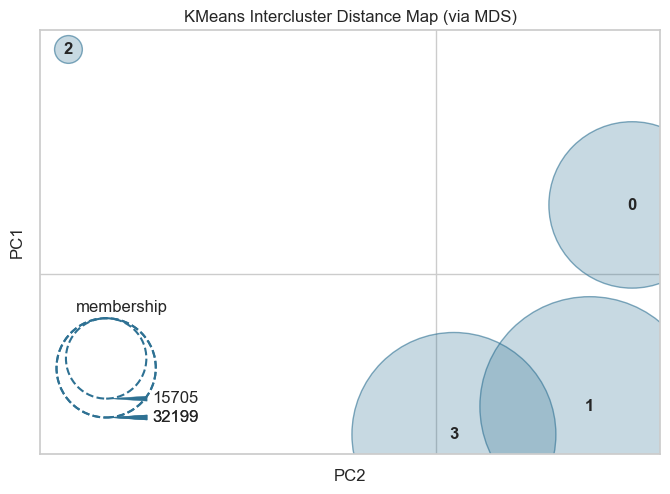

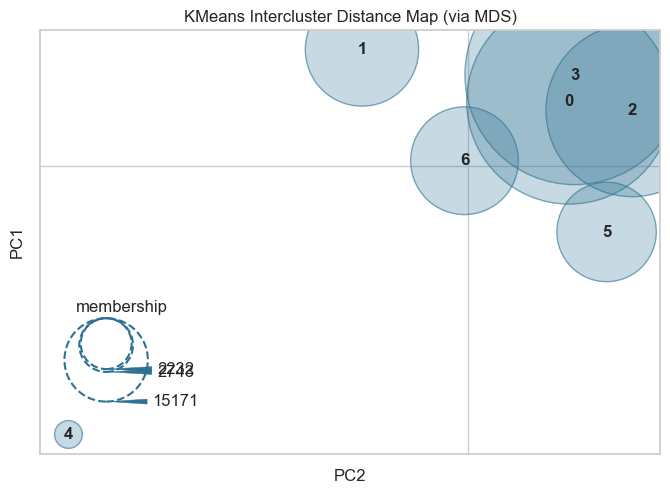

InterclusterDistance(ax=<Axes: title={'center': 'KMeans Intercluster Distance Map (via MDS)'}, xlabel='PC2', ylabel='PC1'>,
                     estimator=KMeans(n_clusters=7, random_state=42))

In [47]:
from yellowbrick.cluster import intercluster_distance

intercluster_distance(KMeans(4, random_state=42), data_scaled)
intercluster_distance(KMeans(7, random_state=42), data_scaled)

In [48]:
df_km_normalized_4 = pd.DataFrame(data_scaled, columns=['Recency', 'Frequency','num_product','MonetaryValue', 'review_score'])

#df_km_normalized['ID'] = df.index
df_km_normalized_4["Cluster"] = kmeans_4.labels_

df_km_melt_4 = pd.melt(df_km_normalized_4.reset_index(),id_vars=[ "Cluster"],
                      value_vars=["Recency", "Frequency", "num_product",
                                  "MonetaryValue", "review_score"
                                   ],
                      var_name="Features",
                      value_name="Value")

df_km_melt_4['Value(log)'] = np.log(df_km_melt_4['Value'])
df_km_melt_4.head(5)

,Cluster,Features,Value,Value(log)
0,7,Recency,-0.842267,NaN
1,1,Recency,-0.822740,NaN
2,12,Recency,1.937480,0.661388
3,4,Recency,0.526791,-0.640951
4,4,Recency,0.311445,-1.166534


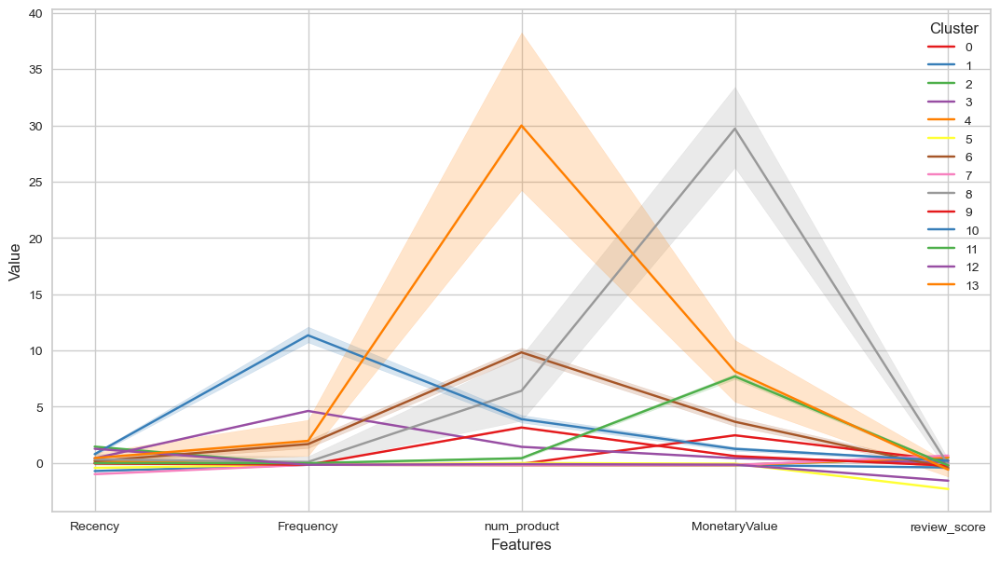

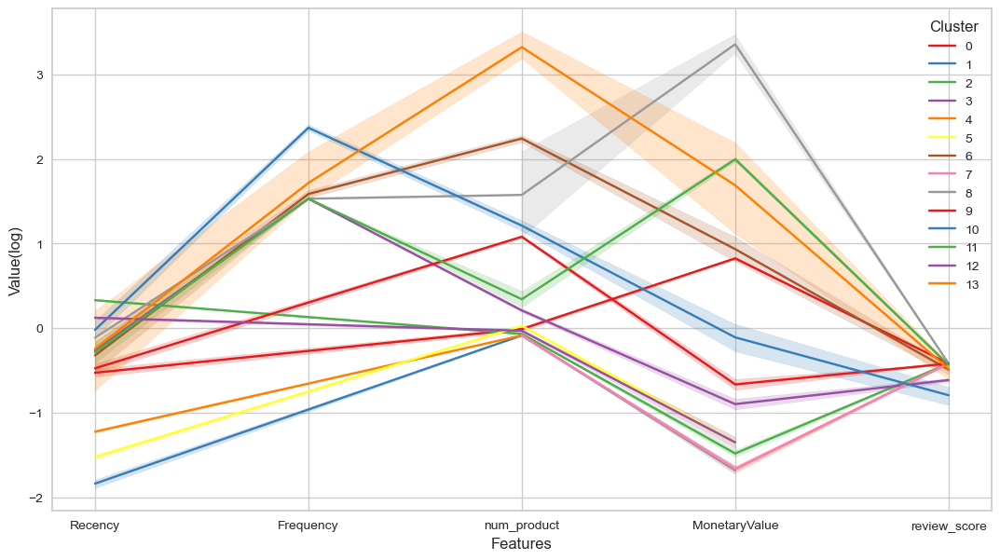

In [49]:
fig, ax = plt.subplots(figsize=(13, 7))
palette = sns.color_palette("Set1", len(df_km_melt_4['Cluster'].unique()))
sns.lineplot(x="Features", y="Value", hue="Cluster", data=df_km_melt_4, palette=palette)
plt.show()

fig, ax = plt.subplots(figsize=(13, 7))
sns.lineplot(x="Features", y="Value(log)", hue="Cluster", data=df_km_melt_4, palette=palette)
plt.show()


In [50]:
df_km_normalized_7 = pd.DataFrame(data_scaled, columns=['Recency', 'Frequency','num_product','MonetaryValue', 'review_score'])

#df_km_normalized['ID'] = df.index
df_km_normalized_7["Cluster"] = kmeans_7.labels_

df_km_melt_7 = pd.melt(df_km_normalized_7.reset_index(),id_vars=[ "Cluster"],
                      value_vars=["Recency", "Frequency", "num_product",
                                  "MonetaryValue", "review_score"
                                   ],
                      var_name="Features",
                      value_name="Value")
df_km_melt_7['Value(log)'] = np.log(df_km_melt_7['Value'])


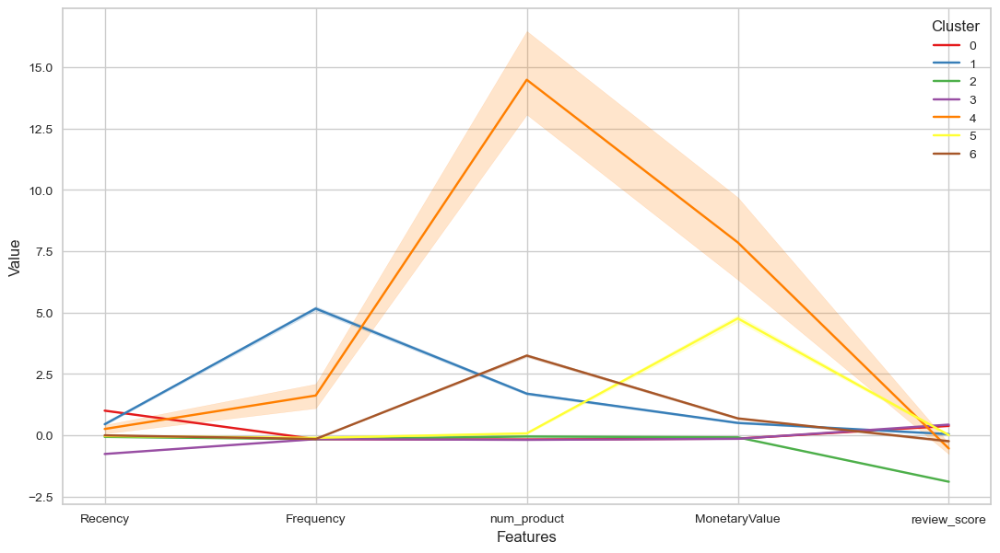

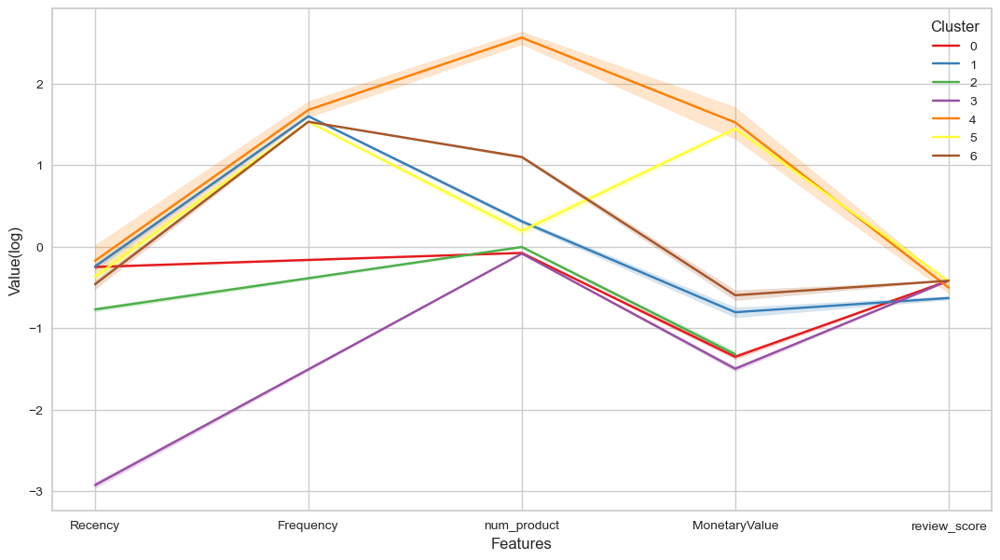

In [51]:
fig, ax = plt.subplots(figsize=(13, 7))
palette = sns.color_palette("Set1", len(df_km_melt_7['Cluster'].unique()))
sns.lineplot(x="Features", y="Value", hue="Cluster", data=df_km_melt_7, palette=palette)
plt.show()

fig, ax = plt.subplots(figsize=(13, 7))
sns.lineplot(x="Features", y="Value(log)", hue="Cluster", data=df_km_melt_7, palette=palette)
plt.show()


**Voici des suggestions de noms pour les groupes en fonction des nouvelles valeurs que vous avez fournies :**

Group 0 : "Clients engagés"
- Ce groupe a une récence moyenne (Recency = 3), une fréquence d'achat moyenne (Frequency = 3), un nombre limité de produits achetés (num_product = 2), une valeur monétaire modérée (MonetaryValue = 2) et des évaluations de satisfaction positives (review_score = 5).

Group 1 : "Clients réguliers satisfaits"
- Ce groupe a une récence relativement faible (Recency = 2), une fréquence d'achat élevée (Frequency = 6), un nombre moyen de produits achetés (num_product = 5), une valeur monétaire significative (MonetaryValue = 4) et des évaluations de satisfaction positives (review_score = 6).

Group 2 : "Clients explorateurs"
- Ce groupe a une récence élevée (Recency = 6), une fréquence d'achat faible (Frequency = 2), un nombre élevé de produits achetés (num_product = 3), une valeur monétaire modérée (MonetaryValue = 3) et des évaluations de satisfaction négatives ou mitigées (review_score = 1).

Group 3 : "Clients à potentiel élevé"
- Ce groupe a une récence élevée (Recency = 7), une fréquence d'achat faible (Frequency = 1), un nombre limité de produits achetés (num_product = 1), une valeur monétaire faible (MonetaryValue = 1) et des évaluations de satisfaction positives (review_score = 7).

Group 4 : "Clients fidèles à budget élevé"
- Ce groupe a une récence faible (Recency = 1), une fréquence d'achat élevée (Frequency = 7), un nombre élevé de produits achetés (num_product = 7), une valeur monétaire élevée (MonetaryValue = 7) et des évaluations de satisfaction négatives ou mitigées (review_score = 2).

Group 5 : "Clients satisfaits réguliers"
- Ce groupe a une récence moyenne (Recency = 4), une fréquence d'achat moyenne à élevée (Frequency = 5), un nombre moyen de produits achetés (num_product = 4), une valeur monétaire élevée (MonetaryValue = 6) et des évaluations de satisfaction positives (review_score = 4).

Group 6 : "Clients inactifs à potentiel élevé"
- Ce groupe a une récence relativement faible (Recency = 5), une fréquence d'achat moyenne (Frequency = 4), un nombre élevé de produits achetés (num_product = 6), une valeur monétaire élevée (MonetaryValue = 5) et des évaluations de satisfaction négatives ou mitigées (review_score = 3).

Ces noms de groupes sont basés sur les nouvelles valeurs que vous avez fournies et peuvent vous aider à mieux comprendre les caractéristiques et les comportements des clients dans chaque groupe. 

**Voici des suggestions d'actions préférées pour chaque groupe en termes de campagnes publicitaires :**

Groupe 0 : "Clients engagés"
- Action préférée : Envoyer des offres spéciales ou des remises exclusives pour les inciter à continuer à acheter et à renforcer leur engagement.

Groupe 1 : "Clients réguliers satisfaits"
- Action préférée : Offrir des programmes de fidélité avantageux, des récompenses ou des privilèges spéciaux pour encourager leur fidélité continue et augmenter leur valeur à long terme.

Groupe 2 : "Clients explorateurs"
- Action préférée : Mettre en avant les nouvelles gammes de produits ou les produits populaires pour les inciter à explorer davantage votre offre et à effectuer des achats supplémentaires.

Groupe 3 : "Clients à potentiel élevé"
- Action préférée : Créer des campagnes personnalisées basées sur leurs préférences et leurs besoins potentiels afin de les convertir en clients réguliers et de maximiser leur valeur.

Groupe 4 : "Clients fidèles à budget élevé"
- Action préférée : Proposer des produits ou services haut de gamme, des options de personnalisation ou des expériences exclusives pour répondre à leurs attentes élevées et les inciter à dépenser davantage.

Groupe 5 : "Clients satisfaits réguliers"
- Action préférée : Solliciter leurs avis et témoignages positifs pour renforcer la confiance des nouveaux clients potentiels et les encourager à acheter.

Groupe 6 : "Clients inactifs à potentiel élevé"
- Action préférée : Envoyer des offres de réactivation personnalisées, telles que des réductions exclusives ou des avantages uniques, pour les inciter à revenir et à réengager avec votre entreprise.

Ces actions préférées sont basées sur les caractéristiques et les comportements des groupes spécifiques, et elles peuvent vous aider à cibler et à personnaliser vos campagnes publicitaires pour maximiser l'impact et les résultats. 

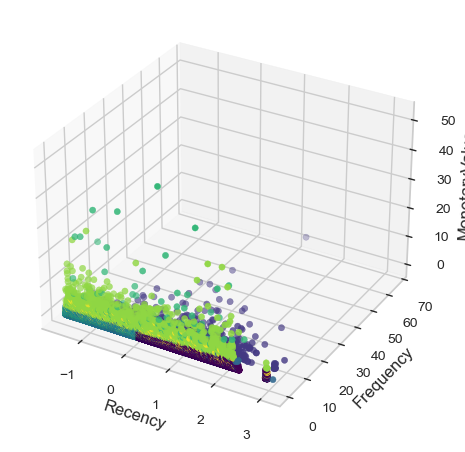

In [52]:
import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Créer une figure en 3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Tracer les points en 3D avec coloration selon "km_clusters"
ax.scatter(df_kmeans_7.Recency, df_kmeans_4.Frequency, df_kmeans_4.MonetaryValue, c=df_kmeans_7['km_clusters'], cmap='viridis')

# Ajouter des labels aux axes
ax.set_xlabel('Recency')
ax.set_ylabel('Frequency')
ax.set_zlabel('MonetaryValue')

# Afficher une légende pour les couleurs
#legend_labels = ['Cluster 0', 'Cluster 1', 'Cluster 2', 'Cluster 3']
#ax.legend(legend_labels)

# Afficher le graphique
plt.show()


In [53]:
import plotly.graph_objects as go

# Données d'exemple
km_clusters = df_kmeans_7['km_clusters']

# Créer une figure en 3D
fig = go.Figure(data=go.Scatter3d(
    x=df_kmeans_7.Recency,
    y=df_kmeans_7.Frequency,
    z=df_kmeans_7.MonetaryValue,
    mode='markers',
    marker=dict(
        size=8,
        color=km_clusters,
        colorscale='viridis',
        opacity=0.8
    )
))

# Définir les labels des axes
fig.update_layout(scene=dict(
    xaxis_title='Recency',
    yaxis_title='Frequency',
    zaxis_title='MonetaryValue'
))

# Afficher le graphique
fig.show()


## KMeans 9-1 variables

In [54]:
df_full = df_init.iloc[:,:-1]
df_full.drop(['payment_installments'], axis=1, inplace = True)

In [55]:
# Création d'un objet StandardScaler
scaler_full = StandardScaler()

# Ajustement du scaler aux données et transformation des données
df_full_s = scaler_full.fit_transform(df_full)

# Affichage des données transformées
#print("Données d'origine :\n", data)
print("Données transformées :\n", df_full_s)

Données transformées :
 [[-0.8422668  -0.1598373  -0.28222026 ... -0.14270105 -0.18712857
  -0.29519594]
 [-0.82273972 -0.1598373  -0.28222026 ... -0.14270105 -0.37801575
  -0.35975329]
 [ 1.93747962 -0.1598373  -0.28222026 ... -0.14270105 -0.18712857
   0.64998857]
 ...
 [ 2.14139489 -0.1598373  -0.28222026 ... -0.14270105 -0.33983832
  -0.40770047]
 [-0.79119808 -0.1598373  -0.28222026 ... -0.14270105 -0.36630801
  -0.37722668]
 [ 1.59150919 -0.1598373  -0.28222026 ... -0.14270105 -0.37377382
  -0.43744184]]


In [56]:
# Création d'un objet PCA avec toutes les composantes principales
n_comp = 2
pca_full = PCA(n_components=n_comp)

# Ajustement du PCA aux données
pca_full.fit(df_full_s)

df_pca_full = pca_full.transform(df_full_s)

# Inertie expliquée par chaque composante principale
explained_variance_full = pca_full.explained_variance_

# Pourcentage d'inertie expliquée par chaque composante principale
explained_variance_ratio_full = pca_full.explained_variance_ratio_

# Composants principaux (vecteurs propres)
components_full = pca_full.components_

Text(0, 0.5, 'Composante 2')

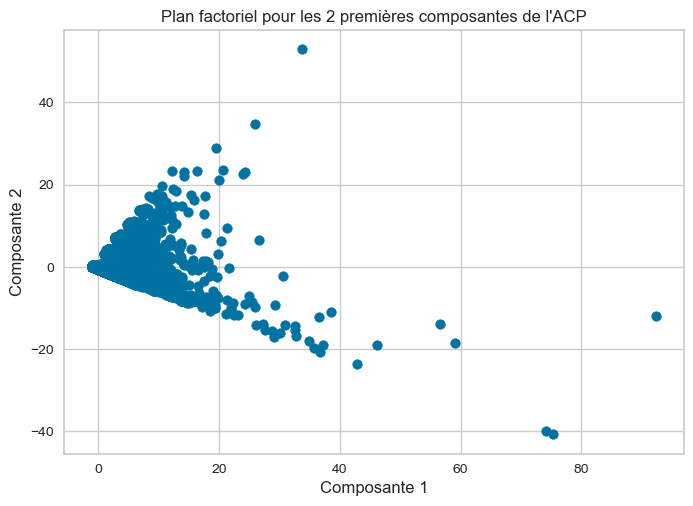

In [57]:
plt.scatter(x = df_pca_full[:,0], y = df_pca_full[:,1])

plt.title("Plan factoriel pour les 2 premières composantes de l'ACP")
plt.xlabel('Composante 1')
plt.ylabel('Composante 2')

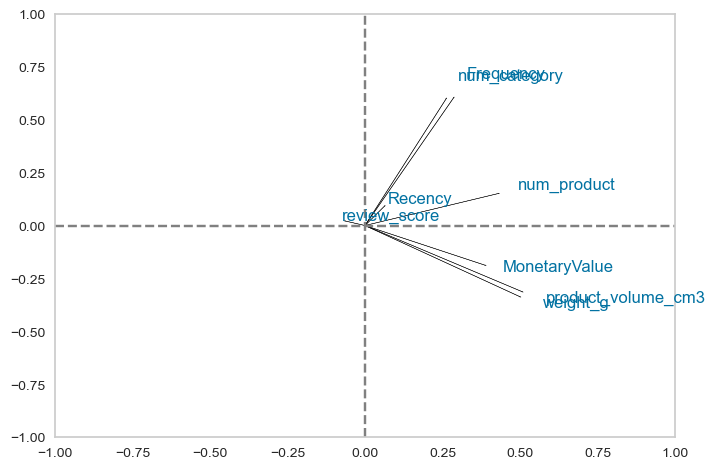

In [58]:
# Obtenez les charges factorielles
loadings_full = pca_full.components_.T

# Définissez les limites du plot
plt.xlim(-1, 1)
plt.ylim(-1, 1)

# Tracez les flèches des charges factorielles
for i, feature in enumerate(df_full.columns):
    plt.arrow(0, 0, loadings_full[i, 0], loadings_full[i, 1], color='black', alpha=0.8)
    plt.text(loadings_full[i, 0] * 1.15, loadings_full[i, 1] * 1.15, feature, color='b')

# Ajoutez des lignes de référence
plt.plot([-1, 1], [0, 0], color='gray', ls='--')
plt.plot([0, 0], [-1, 1], color='gray', ls='--')

# Ajoutez une grille pour une meilleure lisibilité
plt.grid()

# Affichez le plot
plt.show()

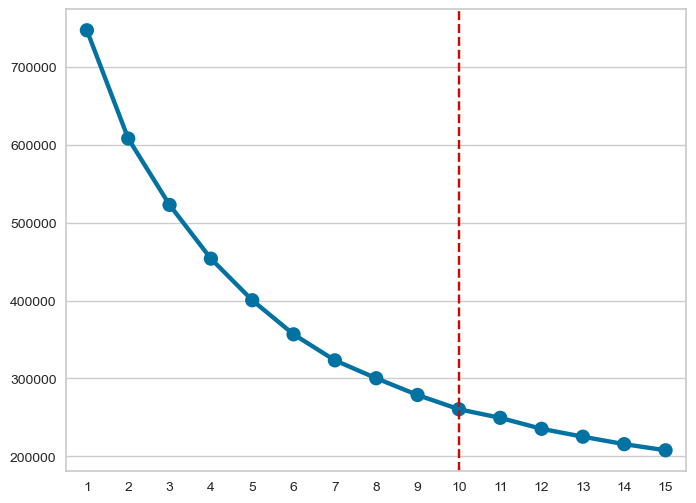

In [59]:
wcss_full = {}
for i in range(1,16):
    kmeans_full = KMeans(n_clusters=  i, init = 'k-means++', max_iter= 300,  random_state = 42) #
    kmeans_full.fit(df_full_s)
    wcss_full[i] = kmeans_full.inertia_
    

plt.figure(figsize = (8,6))
sns.pointplot(x = list(wcss_full.keys()), y = list(wcss_full.values()))

# Tracé de la ligne verticale
plt.axvline(x=9, color='r', linestyle='--')

plt.show();

Silhouette Score: [0.7330068380244217, 0.6155323414680924, 0.3390508472256783, 0.2977631356089069, 0.3052507243484113, 0.31782323606104523, 0.32466633567773123, 0.3272056510866437, 0.3362205056604607, 0.25662990264397023, 0.2578555521332867, 0.2639875045763661, 0.2648253626689216, 0.326828716693557]
Silhouette Score: 0.326828716693557


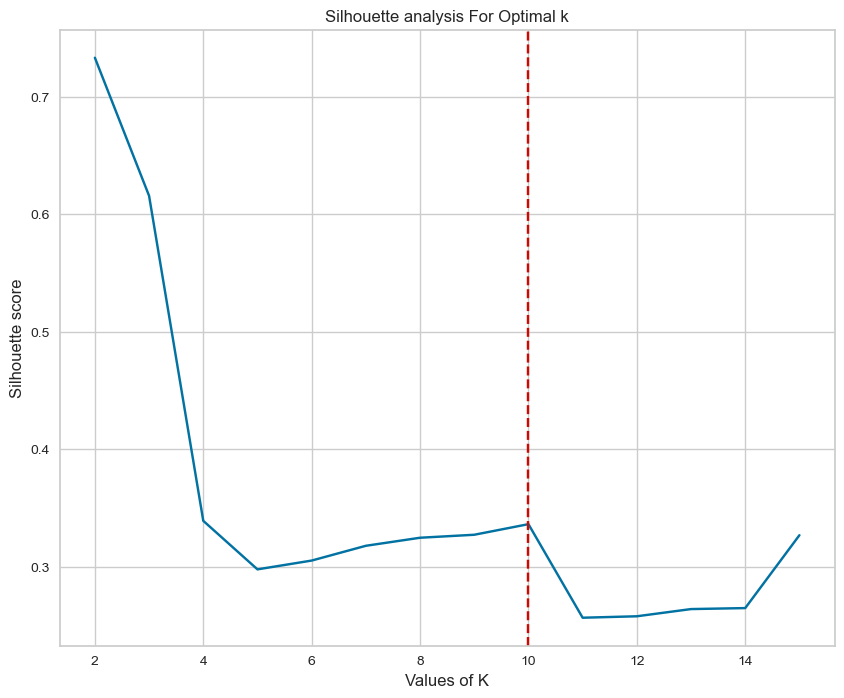

In [60]:
range_n_clusters = [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]
silhouette_avg = []
for num_clusters in range_n_clusters:
 
    # initialise kmeans
    kmeans1_full = KMeans(n_clusters=num_clusters, init = 'k-means++', max_iter= 300,  random_state = 42)
    kmeans1_full.fit(df_full_s)
    cluster_labels_full = kmeans1_full.labels_
 
   # silhouette score
    silhouette_avg.append(silhouette_score(df_full_s, cluster_labels_full))

print("Silhouette Score:" , silhouette_avg)
print("Silhouette Score:", silhouette_score(df_full_s, cluster_labels_full))
    
plt.figure(figsize = (10,8))    
plt.plot(range_n_clusters,silhouette_avg, 'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Silhouette score') 
plt.title('Silhouette analysis For Optimal k')

# Tracé de la ligne verticale
plt.axvline(x=10, color='r', linestyle='--')

plt.show()

In [61]:
# Créer une instance de l'algorithme K-means avec 3 clusters
kmeans_13 = KMeans(n_clusters=10, random_state=42)

# Effectuer le clustering sur les données
kmeans_13.fit(df_full_s)

# Obtenir les labels de cluster assignés à chaque point de données
labels_13 = kmeans_13.labels_

# Obtenir les coordonnées des centres de cluster
centroids_13 = kmeans_13.cluster_centers_

In [62]:
df_kmeans_13 = pd.DataFrame(df_full_s, columns = df_full.columns)
df_kmeans_13['km_clusters'] = labels_13
df_kmeans_13.head()

,Recency,Frequency,num_product,MonetaryValue,review_score,num_category,weight_g,product_volume_cm3,km_clusters
0,-0.842267,-0.159837,-0.28222,-0.120015,0.658078,-0.142701,-0.187129,-0.295196,1
1,-0.822740,-0.159837,-0.28222,-0.563846,-0.124430,-0.142701,-0.378016,-0.359753,1
2,1.937480,-0.159837,-0.28222,-0.335449,-0.906937,-0.142701,-0.187129,0.649989,6
3,0.526791,-0.159837,-0.28222,-0.500275,-0.124430,-0.142701,-0.416193,-0.467079,6
4,0.311445,-0.159837,-0.28222,0.092750,0.658078,-0.142701,0.584904,-0.480602,6


In [63]:
df_kmeans_13['km_clusters'].value_counts()

1    38519
6    29078
0    14193
5     5748
2     1938
4     1317
9     1101
8      821
3      606
7       28
Name: km_clusters, dtype: int64

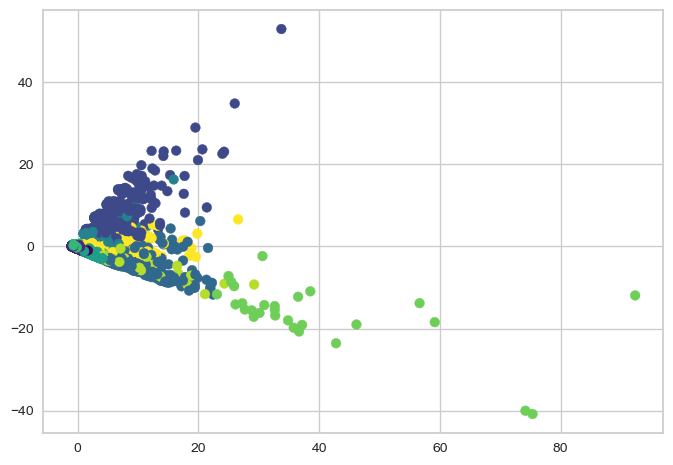

In [64]:
plt.scatter(x = df_pca_full[:,0], y = df_pca_full[:,1], c = df_kmeans_13['km_clusters'], cmap='viridis')


In [65]:
df_km_normalized_13 = pd.DataFrame(df_full_s, columns=df_full.columns)

#df_km_normalized['ID'] = df.index
df_km_normalized_13["Cluster"] = kmeans_13.labels_

df_km_melt_13 = pd.melt(df_km_normalized_13.reset_index(),id_vars=[ "Cluster"],
                      value_vars=df_full.columns,
                      var_name="Features",
                      value_name="Value")
df_km_melt_13['Value(log)'] = np.log(df_km_melt_13['Value'])

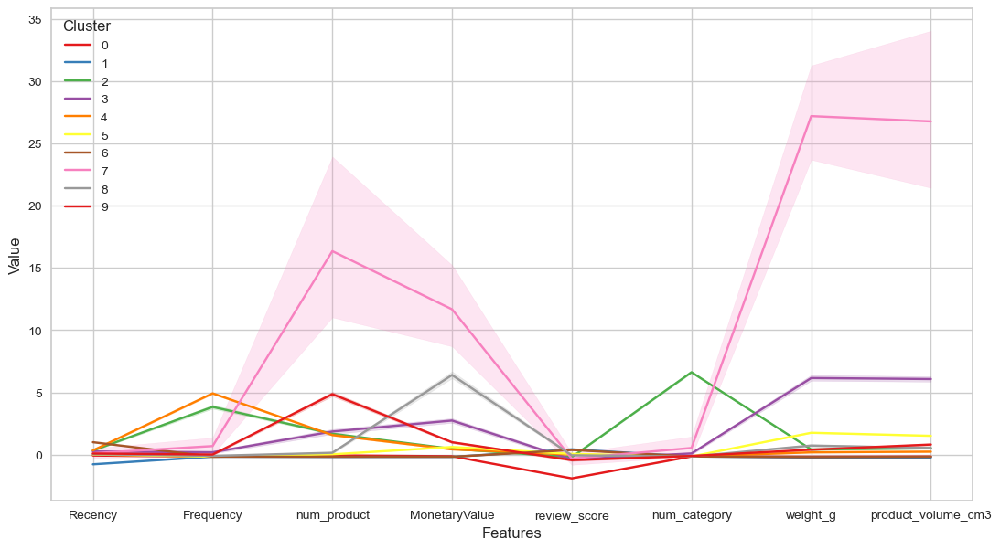

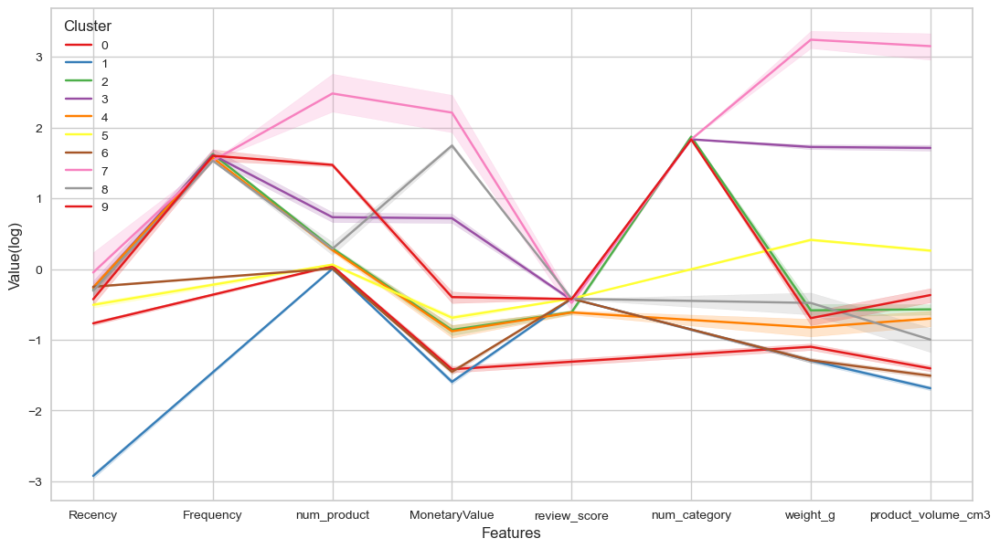

In [66]:
fig, ax = plt.subplots(figsize=(13, 7))
palette = sns.color_palette("Set1", len(df_km_melt_13['Cluster'].unique()))
sns.lineplot(x="Features", y="Value", hue="Cluster", data=df_km_melt_13, palette=palette)
plt.show()

fig, ax = plt.subplots(figsize=(13, 7))
sns.lineplot(x="Features", y="Value(log)", hue="Cluster", data=df_km_melt_13, palette=palette)
plt.show()
